In [23]:
import stlearn as st
st.settings.set_figure_params(dpi=300)
from pathlib import Path
import sys
import pandas as pd
import matplotlib.pyplot as plt
import sys
file = Path("../stimage").resolve()
parent= file.parent
sys.path.append(str(parent))
from PIL import Image
from stimage.utils import gene_plot, Read10X, ReadOldST
from stimage.model import negative_binomial_layer, negative_binomial_loss, CNN_NB_model
from stimage.data_generator import DataGenerator

In [2]:
import numpy as np
import imgaug as ia
from imgaug import augmenters as iaa
%matplotlib inline

ia.seed(3)
sometimes = lambda aug: iaa.Sometimes(0.5, aug)

seq_aug = iaa.Sequential(
    [
        # apply the following augmenters to most images
        iaa.Fliplr(0.5), # horizontally flip 50% of all images
        iaa.Flipud(0.5), # vertically flip 50% of all images
        sometimes(iaa.Affine(
            scale={"x": (0.8, 1.2), "y": (0.8, 1.2)}, # scale images to 80-120% of their size, individually per axis
            rotate=(-45, 45), # rotate by -45 to +45 degrees
        )),
        # execute 0 to 5 of the following (less important) augmenters per image
        # don't execute all of them, as that would often be way too strong
        iaa.SomeOf((0, 1),
            [
                iaa.OneOf([
                    iaa.GaussianBlur((0, 3.0)), # blur images with a sigma between 0 and 3.0
#                     iaa.AverageBlur(k=(2, 7)), # blur image using local means with kernel sizes between 2 and 7
#                     iaa.MedianBlur(k=(3, 11)), # blur image using local medians with kernel sizes between 2 and 7
                ]),
#                 iaa.Sharpen(alpha=(0, 1.0), lightness=(0.75, 1.5)), # sharpen images
#                 iaa.Emboss(alpha=(0, 1.0), strength=(0, 2.0)), # emboss images
# #                 # search either for all edges or for directed edges,
# #                 # blend the result with the original image using a blobby mask
#                 iaa.BlendAlphaSimplexNoise(iaa.OneOf([
#                     iaa.EdgeDetect(alpha=(0.5, 1.0)),
#                     iaa.DirectedEdgeDetect(alpha=(0.5, 1.0), direction=(0.0, 1.0)),
#                 ])),
                iaa.AdditiveGaussianNoise(loc=0, scale=(0.0, 0.05*255), per_channel=0.5), # add gaussian noise to images
#                 iaa.OneOf([
#                     iaa.Dropout((0.01, 0.1), per_channel=0.5), # randomly remove up to 10% of the pixels
#                     iaa.CoarseDropout((0.03, 0.15), size_percent=(0.02, 0.05), per_channel=0.2),
#                 ]),
#                 iaa.Invert(0.05, per_channel=True), # invert color channels
#                 iaa.Add((-10, 10), per_channel=0.5), # change brightness of images (by -10 to 10 of original value)
                iaa.AddToHueAndSaturation((-20, 20)), # change hue and saturation
# #                 # either change the brightness of the whole image (sometimes
# #                 # per channel) or change the brightness of subareas
#                 iaa.LinearContrast((0.5, 2.0), per_channel=0.5), # improve or worsen the contrast
                iaa.Grayscale(alpha=(0.0, 1.0)),
#                 sometimes(iaa.ElasticTransformation(alpha=(0.5, 3.5), sigma=0.25)), # move pixels locally around (with random strengths)
#                 sometimes(iaa.PiecewiseAffine(scale=(0.01, 0.05))), # sometimes move parts of the image around
#                 sometimes(iaa.PerspectiveTransform(scale=(0.01, 0.1)))
            ],
            random_order=True
        )
    ],
    random_order=True
)

def tf_seq(image, label):
    im_shape = image.shape
    [image,] = tf.py_function(lambda x:seq_aug(images=x), [image], [tf.float32])
    image.set_shape(im_shape)
    return image, label

In [3]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input as preprocess_resnet
import numpy as np
from tensorflow.keras.models import Model

class DataGenerator(keras.utils.Sequence):
    'Generates data for Keras'

    def __init__(self, adata, dim=(299, 299), n_channels=3, genes=None, aug=False):
        'Initialization'
        self.dim = dim
        self.adata = adata
        self.n_channels = n_channels
        self.genes = genes
        self.num_genes = len(genes)
        self.aug = aug
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(self.adata.n_obs)

    def __getitem__(self, index):
        'Generate one batch of data'
        # Find list of IDs
        obs_temp = self.adata.obs_names[index]

        # Generate data
        X_img = self._load_img(obs_temp)
        y = self._load_label(obs_temp)

        return X_img, y


    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(self.adata.n_obs)


    def _load_img(self, obs):
        img_path = self.adata.obs.loc[obs, 'tile_path']
        X_img = image.load_img(img_path, target_size=self.dim)
        X_img = image.img_to_array(X_img).astype('uint8')
#         X_img = np.expand_dims(X_img, axis=0)
#         n_rotate = np.random.randint(0, 4)
#         X_img = np.rot90(X_img, k=n_rotate, axes=(1, 2))
        if self.aug:
            X_img = seq_aug(image=X_img)
        X_img = preprocess_resnet(X_img)
        return X_img

    def _load_label(self, obs):
        return self.adata.to_df().loc[obs, self.genes]

    def get_classes(self):
        return self.adata.to_df().loc[:,self.genes]

In [33]:
BASE_PATH = Path("/clusterdata/uqxtan9/Xiao/STimage/dataset/breast_cancer_10x_visium")
TILE_PATH = Path("/tmp") / "tiles"
TILE_PATH.mkdir(parents=True, exist_ok=True)

In [34]:
SAMPLE = "block1"
Sample1 = st.Read10X(BASE_PATH / SAMPLE, 
                  library_id=SAMPLE, 
                  count_file="V1_Breast_Cancer_Block_A_Section_1_filtered_feature_bc_matrix.h5",
                  quality="fulres",)
                  #source_image_path=BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif")
img = plt.imread(BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif", 0)
Sample1.uns["spatial"][SAMPLE]['images']["fulres"] = img

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [35]:
SAMPLE = "block2"
Sample2 = st.Read10X(BASE_PATH / SAMPLE, 
                  library_id=SAMPLE, 
                  count_file="V1_Breast_Cancer_Block_A_Section_2_filtered_feature_bc_matrix.h5",
                  quality="fulres",)
                  #source_image_path=BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif")
img = plt.imread(BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_2_image.tif", 0)
Sample2.uns["spatial"][SAMPLE]['images']["fulres"] = img

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [36]:
gene_list=["SLITRK6", "PGM5", "LINC00645", 
           "TTLL12", "COX6C", "CPB1",
           "KRT5", "MALAT1"]
gene = gene_list[3]

In [37]:
for adata in [
    Sample1,
    Sample2,
]:
#     count_df = adata.to_df()
#     count_df[count_df <=1] = 0
#     count_df[count_df >1] = 1
#     adata.X = count_df
#     adata[:,gene_list]
#     st.pp.filter_genes(adata,min_cells=1)
    st.pp.normalize_total(adata)
    st.pp.log1p(adata)
#     st.pp.scale(adata)

    # pre-processing for spot image
    TILE_PATH_ = TILE_PATH / list(adata.uns["spatial"].keys())[0]
    TILE_PATH_.mkdir(parents=True, exist_ok=True)
    st.pp.tiling(adata, TILE_PATH_, crop_size=299)
#     st.pp.extract_feature(adata)

Normalization step is finished in adata.X
Log transformation step is finished in adata.X


Tiling image: 100%|██████████ [ time left: 00:00 ]


Normalization step is finished in adata.X
Log transformation step is finished in adata.X


Tiling image: 100%|██████████ [ time left: 00:00 ]


In [38]:
training_index = Sample1.obs.sample(frac=0.7, random_state=1).index
training_dataset = Sample1[training_index,].copy()

valid_index = Sample1.obs.index.isin(training_index)
valid_dataset = Sample1[~valid_index,].copy()

test_dataset = Sample2.copy()

In [39]:
train_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator(adata=training_dataset, 
                          genes=[gene], aug=True), 
            output_types=(tf.float32, tf.float32), 
            output_shapes=([299,299,3], [1])
)
train_gen_ = train_gen.shuffle(buffer_size=500).batch(128).repeat(3).cache().prefetch(tf.data.experimental.AUTOTUNE)
valid_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator(adata=valid_dataset, 
                          genes=[gene]), 
            output_types=(tf.float32, tf.float32), 
            output_shapes=([299,299,3], [1])
)
valid_gen_ = valid_gen.shuffle(buffer_size=500).batch(128).repeat(3).cache().prefetch(tf.data.experimental.AUTOTUNE)
test_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator(adata=test_dataset, 
                          genes=[gene]), 
            output_types=(tf.float32, tf.float32), 
            output_shapes=([299,299,3], [1])
)
test_gen_ = test_gen.batch(1)

In [117]:
def show(img, label):
    plt.figure()
    plt.imshow(img.numpy().astype("uint8"))
    plt.title(str(label.numpy()))
    plt.axis('off')

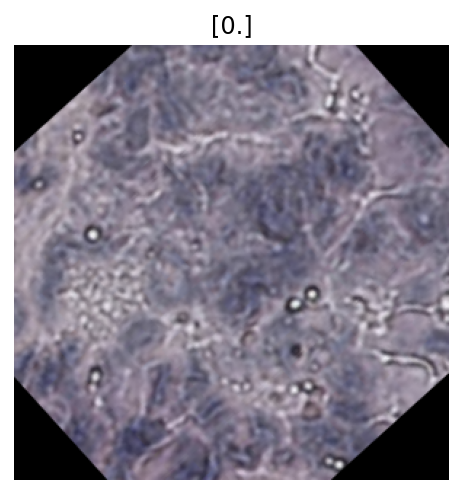

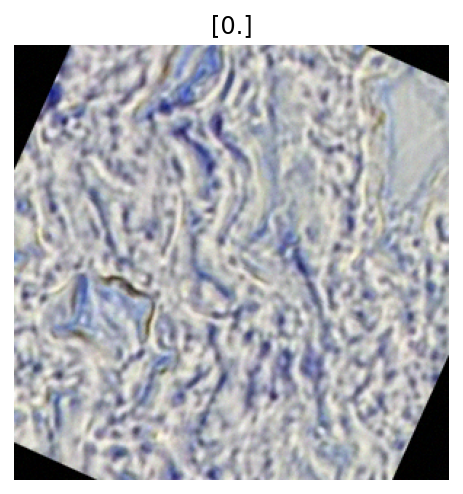

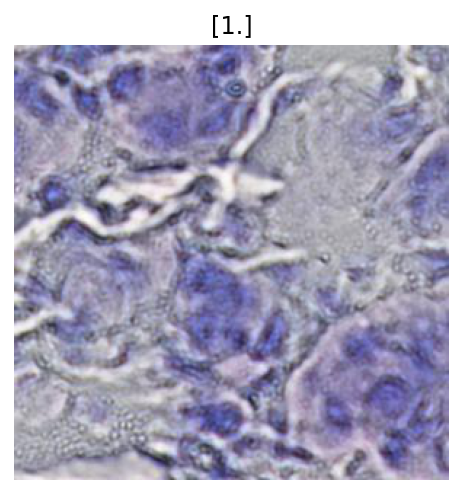

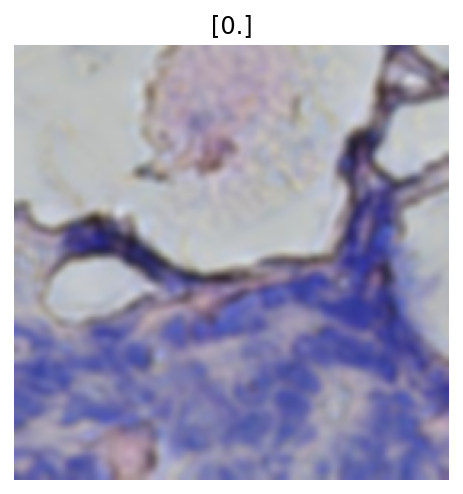

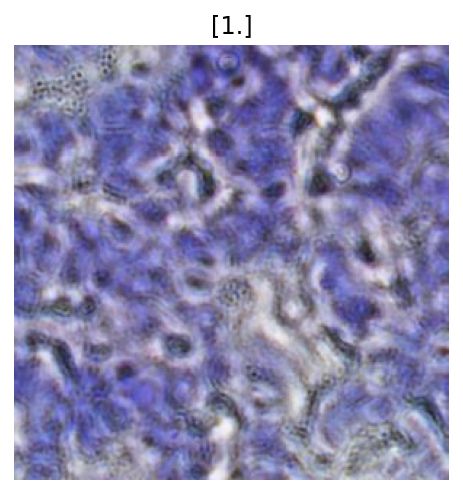

...

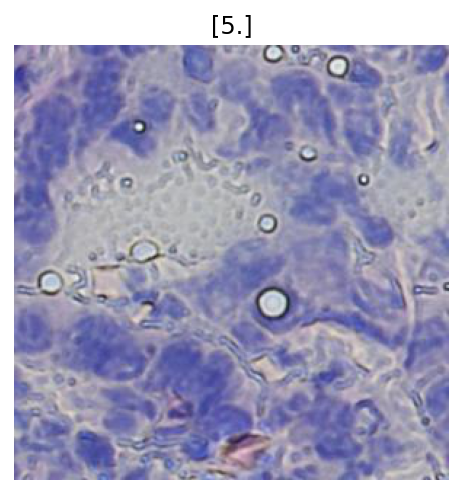

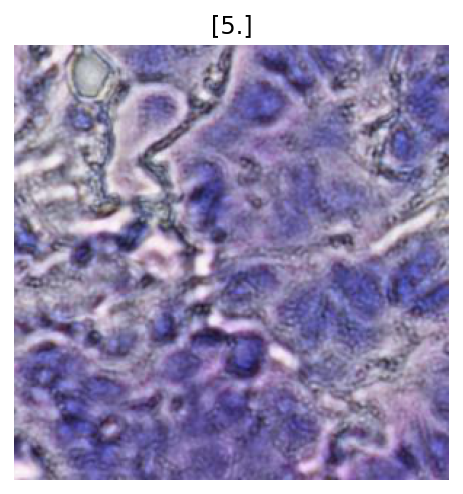

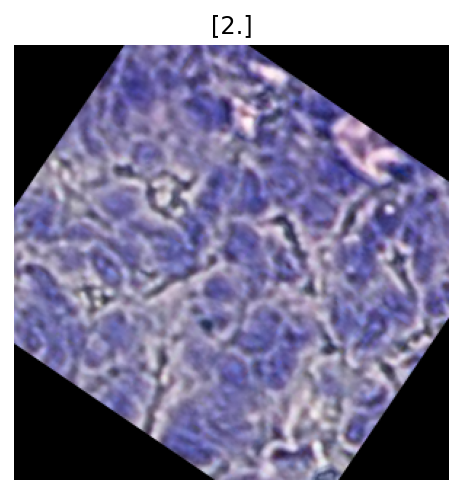

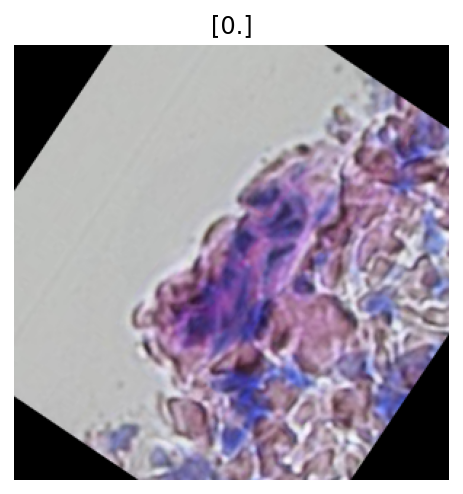

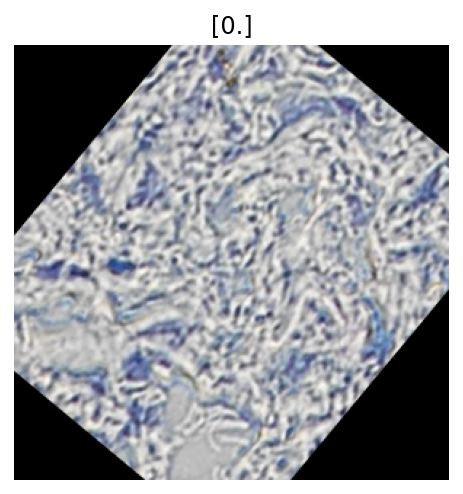

In [118]:
for img, label in train_gen.take(20):
    show(img, label)

In [119]:
for images, labels in train_gen_.take(1):
    print('images.shape: ', images.shape)
    print('labels.shape: ', labels.shape)

images.shape:  (128, 299, 299, 3)
labels.shape:  (128, 1)


In [121]:
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Input, concatenate, Dropout, Lambda

def CNN_NB(tile_shape):
    tile_input = Input(shape=tile_shape, name = "tile_input")
    resnet_base = ResNet50(input_tensor=tile_input, weights='imagenet', include_top=False)
    stage_5_start = resnet_base.get_layer("conv5_block1_1_conv")
    for i in range(resnet_base.layers.index(stage_5_start)):
        resnet_base.layers[i].trainable = False

    cnn = resnet_base.output
    cnn = GlobalAveragePooling2D()(cnn)
    cnn = Dropout(0.5)(cnn)
    cnn = Dense(512, activation='relu', kernel_regularizer=keras.regularizers.l1(0.1),
                activity_regularizer=keras.regularizers.l2(0.01))(cnn)
    # cnn = Dense(256, activation='relu')(cnn)
    outputs = Dense(2)(cnn)
    distribution_outputs = Lambda(negative_binomial_layer)(outputs)
    model = Model(inputs=tile_input, outputs=distribution_outputs)

    # optimizer = tf.keras.optimizers.RMSprop(0.0001)
    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss=negative_binomial_loss,
                  optimizer=optimizer,
                  metrics=[negative_binomial_loss])    
    return model




In [40]:
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input as preprocess_vgg16

from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Input, concatenate, Dropout, Lambda

def vgg16_NB(tile_shape):
    tile_input = Input(shape=tile_shape, name = "tile_input")
    VGG16_base = VGG16(input_tensor=tile_input, weights='imagenet', include_top=False)

    cnn = VGG16_base.output
    cnn = GlobalAveragePooling2D()(cnn)
    cnn = Dropout(0.5)(cnn)
    cnn = Dense(512, activation='relu', kernel_regularizer=keras.regularizers.l1(0.01),
                activity_regularizer=keras.regularizers.l2(0.01))(cnn)
    # cnn = Dense(256, activation='relu')(cnn)
    outputs = Dense(2)(cnn)
    distribution_outputs = Lambda(negative_binomial_layer)(outputs)
    model = Model(inputs=tile_input, outputs=distribution_outputs)

    optimizer = tf.keras.optimizers.RMSprop(0.0001)
#     optimizer = tf.keras.optimizers.Adam()

    model.compile(loss=negative_binomial_loss,
                  optimizer=optimizer,
                  metrics=[negative_binomial_loss])    
    return model

In [41]:
model = vgg16_NB((299, 299, 3))

In [42]:
callback = tf.keras.callbacks.EarlyStopping(monitor='val_negative_binomial_loss', patience=10,
                                            restore_best_weights=True)

In [43]:
train_history = model.fit(train_gen_,
                          epochs=100,
                          validation_data=valid_gen_,
                          callbacks=[callback])

Epoch 1/100
63/63 [==============================] - 1383s 21s/step - loss: 99.7930 - negative_binomial_loss: 1.9009 - val_loss: 85.3833 - val_negative_binomial_loss: 1.5773
Epoch 2/100
63/63 [==============================] - 71s 1s/step - loss: 81.7149 - negative_binomial_loss: 1.5629 - val_loss: 70.9757 - val_negative_binomial_loss: 1.5455
Epoch 3/100
63/63 [==============================] - 71s 1s/step - loss: 67.6411 - negative_binomial_loss: 1.5247 - val_loss: 57.9768 - val_negative_binomial_loss: 1.5499
Epoch 4/100
63/63 [==============================] - 71s 1s/step - loss: 54.9520 - negative_binomial_loss: 1.5087 - val_loss: 46.2688 - val_negative_binomial_loss: 1.4963
Epoch 5/100
63/63 [==============================] - 71s 1s/step - loss: 43.5986 - negative_binomial_loss: 1.4700 - val_loss: 35.9312 - val_negative_binomial_loss: 1.4554
Epoch 6/100
63/63 [==============================] - 71s 1s/step - loss: 33.6106 - negative_binomial_loss: 1.4446 - val_loss: 26.9637 - val_ne

In [44]:
test_predictions = model.predict(test_gen_)
from scipy.stats import nbinom
n = test_predictions[:,0]; p = test_predictions[:,1]
y_pred = nbinom.mean(n,p)
test_dataset.obsm["predicted_gene"] = y_pred

In [45]:
test_dataset_ = test_dataset[:,gene].copy()
test_dataset_.X = test_dataset_.obsm["predicted_gene"]

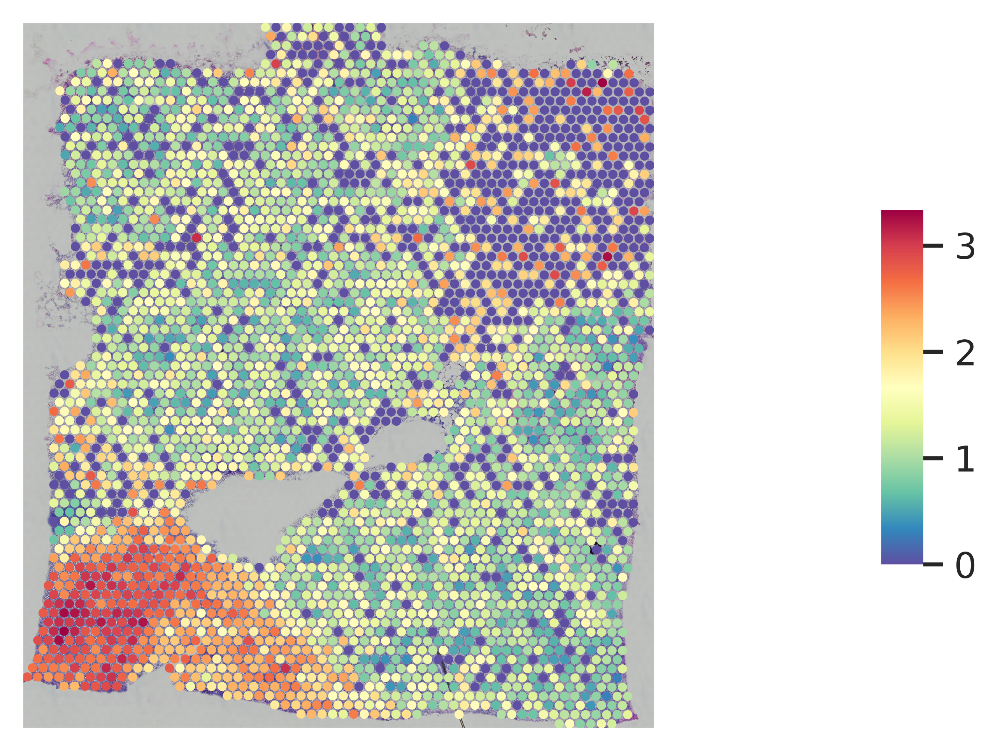

In [46]:
gene_plot(Sample1, genes=gene, spot_size=8)

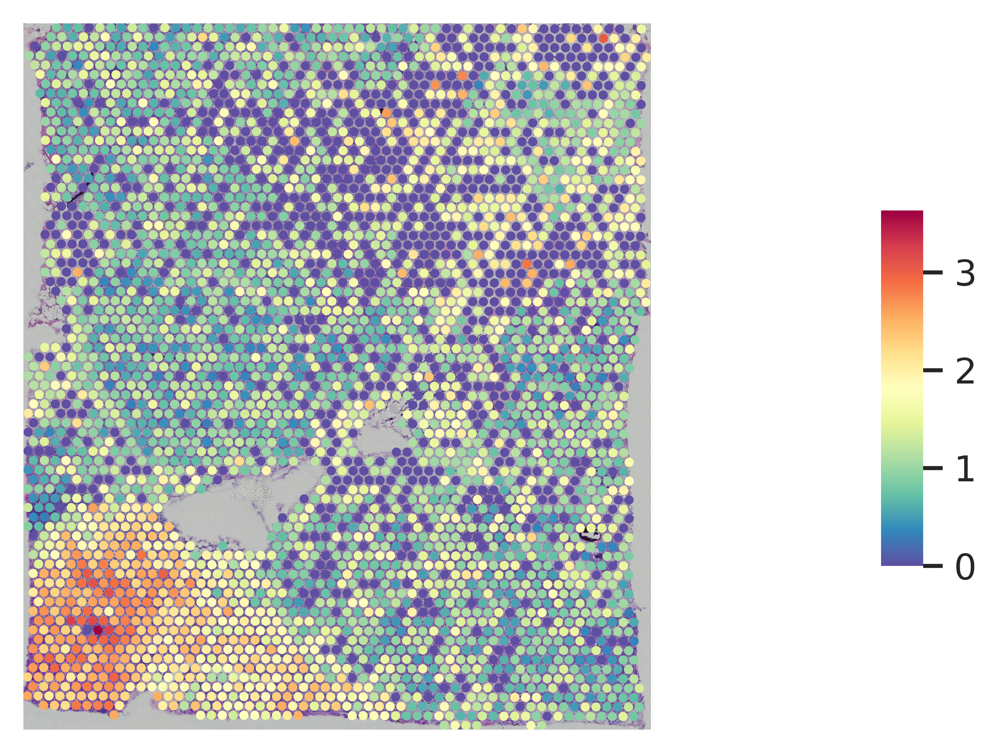

In [47]:
gene_plot(Sample2, genes=gene, spot_size=8)

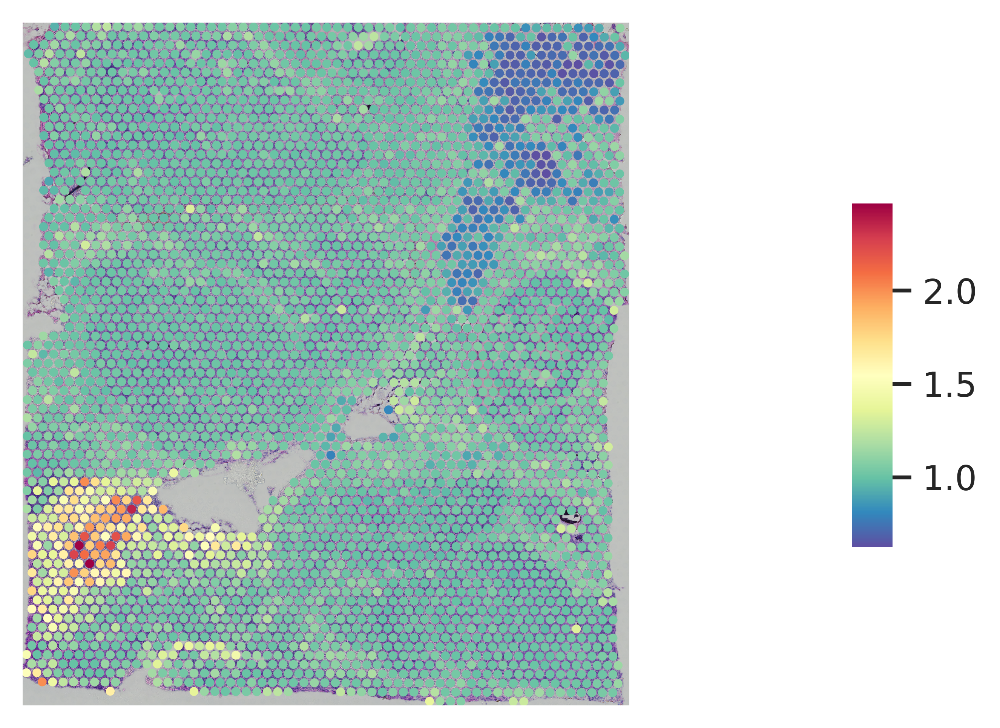

In [48]:
gene_plot(test_dataset_, genes=gene, spot_size=8)

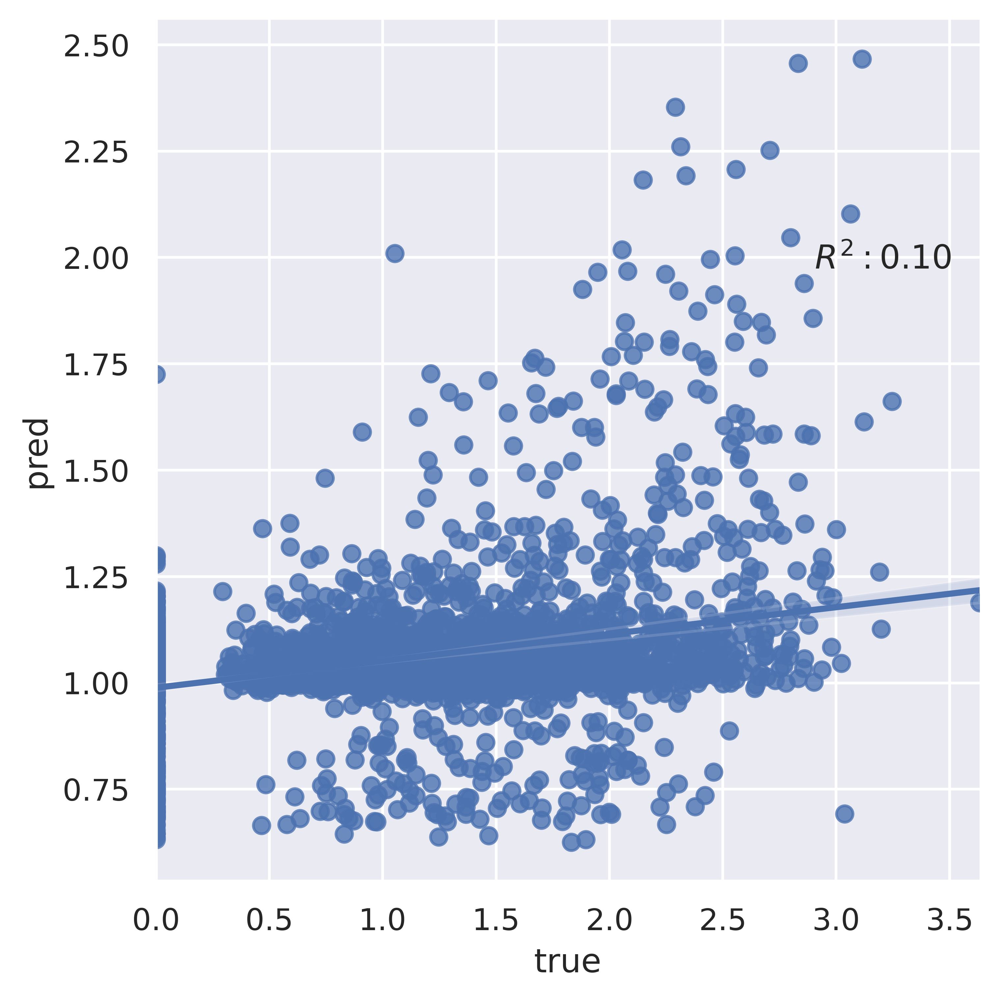

In [49]:
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats

true_y = np.array(test_dataset[:,gene].to_df()).ravel()
pred_y = np.array(test_dataset_[:,gene].to_df()).ravel()
df = pd.DataFrame({"true_y":true_y, "pred_y":pred_y})
r2 = stats.pearsonr(true_y, 
                    pred_y)[0] ** 2
sns.set_theme()
g = sns.lmplot(data=df,
    x="true_y", y="pred_y",
    height=5, legend=True
)
# g.set(ylim=(0, 360), xlim=(0,360))

g.set_axis_labels("true", "pred")
plt.annotate(r'$R^2:{0:.2f}$'.format(r2),
            (max(true_y)*0.8, max(pred_y)*0.8))
plt.show()